In [1]:
import pprint
import numpy as np
import matplotlib.pyplot as plt
import sys
sys.path.append("..")

import suite2p
from suite2p.registration import register
from scanimagetiffio import SITiffIO

from utils_image import UnrotateFrame_SITiffIO

In [2]:
#%% read a tiff file and calculate the rotation angle of each frame
dataFolder = '/home/zilong/Desktop/2D2P/Data/162_10072023/'
tiffpath = dataFolder+ '162_block1_00001.tif'
relogfile = dataFolder + 'REdata_20230706_164845.txt'

S = SITiffIO()
S.open_tiff_file(tiffpath, "r")
S.open_rotary_file(relogfile)
Array, Angles = S.tail(1000)

Loading rotary encoder file: /home/zilong/Desktop/2D2P/Data/162_10072023/REdata_20230706_164845.txt
Calculating rotations and times from rotary encoder data...
Finished calculating rotations and times.
The rotary encoder file has 75058 timestamps in it.
Counted 18000 frames


In [3]:
Array.shape

(1000, 512, 512)

In [2]:
#%% read a tiff file and calculate the rotation angle of each frame
dataFolder = '/home/zilong/Desktop/2D2P/Data/'
tiffpath = dataFolder+ '162_block1_19062023__00001.tif'
relogfile = dataFolder + 'REdata_20230619_170256.txt'
savename = dataFolder + 'temp.tif'

S = SITiffIO()
S.open_tiff_file(tiffpath, "r")
S.save_tail(1000, savename) #save the last 1000 frames to a new tiff file

#load the new tiff file together with the rotary data
S.open_tiff_file(savename, "r") 
S.open_rotary_file(relogfile)
S.interp_times()  # might take a while...

Written 1000 frames to /home/zilong/Desktop/2D2P/Data/temp.tif
Loading rotary encoder file: /home/zilong/Desktop/2D2P/Data/REdata_20230619_170256.txt
Calculating rotations and times from rotary encoder data...
Finished calculating rotations and times.
The rotary encoder file has 79743 timestamps in it.
Counted 1000 frames


In [3]:
#unrotated frames in the tail tiff file
UnrotatedFrames = UnrotateFrame_SITiffIO(S, rotCenter=[246,235], numFrames=None)


In [4]:
# prepare configurations using the ops dictionary
ops = suite2p.default_ops()
ops['batch_size'] = 200 # we will decrease the batch_size in case low RAM on computer
ops['block_size'] = [64,64]
ops['fs'] = 30 # sampling rate of recording, determines binning for cell detection
ops['tau'] = 0.7 # timescale of gcamp to use for deconvolution
#print ops not in a single line, but in a more readable way
pp = pprint.PrettyPrinter(indent=4)
pp.pprint(ops)

{   '1Preg': False,
    'align_by_chan': 1,
    'allow_overlap': False,
    'anatomical_only': 0,
    'aspect': 1.0,
    'baseline': 'maximin',
    'batch_size': 200,
    'bidi_corrected': False,
    'bidiphase': 0,
    'block_size': [64, 64],
    'bruker': False,
    'bruker_bidirectional': False,
    'cellprob_threshold': 0.0,
    'chan2_thres': 0.65,
    'classifier_path': '',
    'combined': True,
    'connected': True,
    'delete_bin': False,
    'denoise': False,
    'diameter': 0,
    'do_bidiphase': False,
    'do_registration': True,
    'fast_disk': [],
    'flow_threshold': 1.5,
    'force_refImg': False,
    'force_sktiff': False,
    'frames_include': -1,
    'fs': 30,
    'functional_chan': 1,
    'h5py': [],
    'h5py_key': 'data',
    'high_pass': 100,
    'ignore_flyback': [],
    'inner_neuropil_radius': 2,
    'keep_movie_raw': False,
    'lam_percentile': 50.0,
    'look_one_level_down': False,
    'max_iterations': 20,
    'max_overlap': 0.75,
    'maxregshift': 0

In [5]:
#perform image registration with built-in suite2p function
regframes = np.zeros_like(UnrotatedFrames)
refImg, rmin, rmax, mean_img, rigid_offsets, nonrigid_offsets, zest = register.compute_reference_and_register_frames(UnrotatedFrames, f_align_out=regframes, refImg=None, ops=ops)

Reference frame, 4.31 sec.
Registered 200/1000 in 2.05s
Registered 400/1000 in 3.99s
Registered 600/1000 in 5.85s
Registered 800/1000 in 7.68s
Registered 1000/1000 in 9.89s


In [9]:
# Figure Style settings for notebook.
import matplotlib as mpl
mpl.rcParams.update({
    'axes.spines.left': True,
    'axes.spines.bottom': True,
    'axes.spines.top': False,
    'axes.spines.right': False,
    'legend.frameon': False,
    'figure.subplot.wspace': .05,
    'figure.subplot.hspace': .05,
    'figure.figsize': (9, 6),
    'ytick.major.left': True,
})
jet = mpl.cm.get_cmap('jet')
jet.set_bad(color='k')

/tmp/ipykernel_2037875/1325982274.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = mpl.cm.get_cmap('jet')


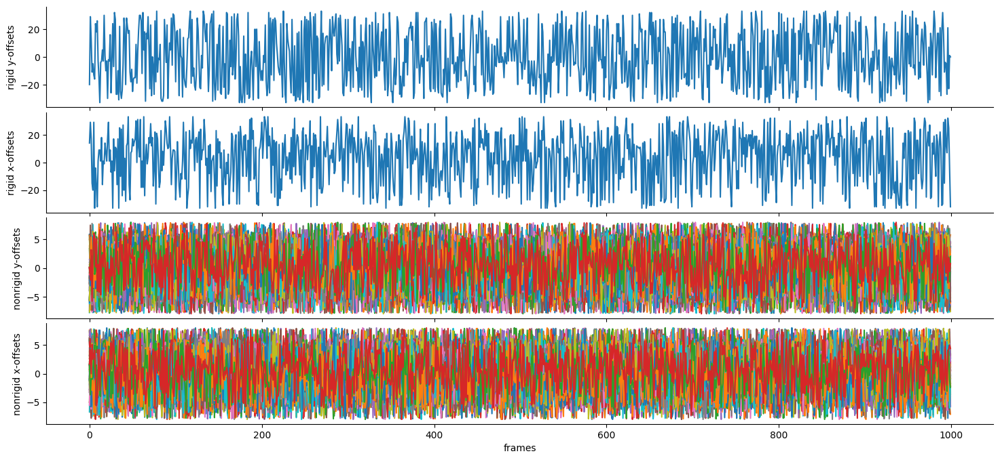

In [10]:
plt.figure(figsize=(18,8))

plt.subplot(4,1,1)
plt.plot(rigid_offsets[0][:1000])
plt.ylabel('rigid y-offsets')

plt.subplot(4,1,2)
plt.plot(rigid_offsets[1][:1000])
plt.ylabel('rigid x-offsets')

plt.subplot(4,1,3)
plt.plot(nonrigid_offsets[0][:1000])
plt.ylabel('nonrigid y-offsets')

plt.subplot(4,1,4)
plt.plot(nonrigid_offsets[1][:1000])
plt.ylabel('nonrigid x-offsets')
plt.xlabel('frames')

plt.show()

(-0.5, 331.5, 331.5, -0.5)

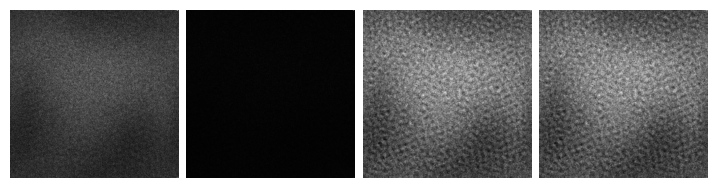

In [11]:
plt.subplot(1, 4, 1)
#plot the mean frames in UnrotatedFrames
plt.imshow(np.mean(UnrotatedFrames, axis=0), cmap='gray')
#axis off
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(refImg, cmap='gray')
plt.axis('off')

plt.subplot(1, 4, 3)
plt.imshow(mean_img, cmap='gray')
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(np.mean(regframes, axis=0), cmap='gray')
plt.axis('off')



Animation size has reached 21076515 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


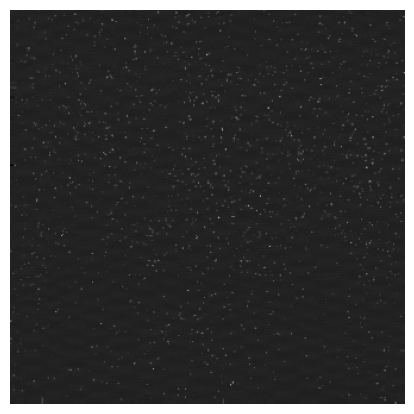

In [12]:
#make a movie of the unrotated frames in 30 fps
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(512/100,512/100),dpi=100)
im = plt.imshow(regframes[0,:,:], animated=True, cmap='gray')
plt.axis('off')

def updatefig(i):
    im.set_array(regframes[i,:,:])
    return im,

ani = animation.FuncAnimation(fig, updatefig, frames=regframes.shape[0], interval=33, blit=True)
HTML(ani.to_jshtml())

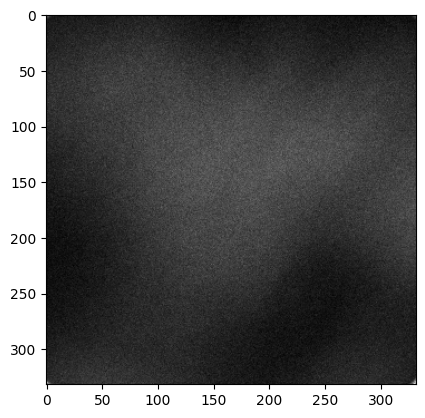

In [26]:
#average the unrotated frames and plot the mean image
meanimage = np.mean(np.asarray(UnrotatedFrames), axis=0)
plt.imshow(meanimage, cmap='gray')


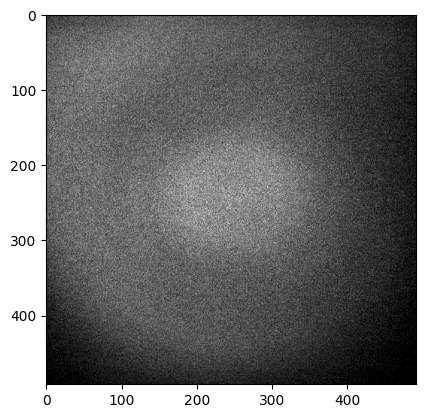

In [7]:
from matplotlib import pyplot as plt
#get 5000 frames from SITiffIO and save them in a list
frames = []
for i in range(1000):
    frames.append(S.get_frame(i+1))

#chaneg to nparray
frames_np = np.array(frames)


#normalze the mean frame to 0-255
meanframe = np.mean(frames_np, axis=0)  
meanframe = (meanframe - np.min(meanframe))/(np.max(meanframe)-np.min(meanframe))*255
#uint8
meanframe = meanframe.astype(np.uint8)

#cut the edge 10 pixels
meanframe = meanframe[10:-10,10:-10]
    
#show the mean frame
plt.imshow(meanframe, cmap='gray')
